<a href="https://colab.research.google.com/github/berthine/Research_Project_T-bingen_Cg/blob/main/CLIP_embedding.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#pip install ftfy
#pip install regex
#pip install clip

In [ ]:
#python3.10 -m pip install ipykernel

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from glob import glob
import seaborn as sns
import os
from itertools import chain
import json
#!python --version

### 1. Data Exploration

In [ ]:
xray_data = pd.read_csv('/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/Data_Entry_2017.csv')
# print the number of observations
num_obs = len(xray_data)
print('Number of observations:',num_obs)

Number of observations: 112120


In [ ]:
#Print the uniques labels

#ray_data['Finding Labels'] = xray_data['Finding Labels'].map(lambda x: x.replace('No Finding', ''))
labels = np.unique(list(chain(*xray_data['Finding Labels'].map(lambda x: x.split('|')).tolist())))
labels_list = [x for x in labels if len(x) > 0]
print('Unique labels: ', len(labels_list))
labels_list

Unique labels:  15


['Atelectasis',
 'Cardiomegaly',
 'Consolidation',
 'Edema',
 'Effusion',
 'Emphysema',
 'Fibrosis',
 'Hernia',
 'Infiltration',
 'Mass',
 'No Finding',
 'Nodule',
 'Pleural_Thickening',
 'Pneumonia',
 'Pneumothorax']

In [ ]:
# To return all file paths that match a specific pattern

my_glob = glob('/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images*/images/*.png')

# check to make sure that all the pathway are captured
print('Number of Observations: ', len(my_glob))

#map each image index to his full path

full_img_paths = {os.path.basename(x): x for x in my_glob}
xray_data['full_path'] = xray_data['Image Index'].map(full_img_paths.get)

#drop the unecessary columns
xray_data = xray_data.drop(['Follow-up #', 'Patient ID','Patient Age', 'Patient Gender', 'View Position', 'OriginalImage[Width','Height]', 'OriginalImagePixelSpacing[x', 'y]', 'Unnamed: 11'], axis=1)

xray_data.head()

Number of Observations:  112119


,Image Index,Finding Labels,full_path
0,00000001_000.png,Cardiomegaly,/graphics/scratch2/students/mpindabe/Datasets/...
1,00000001_001.png,Cardiomegaly|Emphysema,/graphics/scratch2/students/mpindabe/Datasets/...
2,00000001_002.png,Cardiomegaly|Effusion,/graphics/scratch2/students/mpindabe/Datasets/...
3,00000002_000.png,No Finding,/graphics/scratch2/students/mpindabe/Datasets/...
4,00000003_000.png,Hernia,/graphics/scratch2/students/mpindabe/Datasets/...


In [ ]:
new_csv_file = '/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/new_xray.csv'
xray_data.to_csv(new_csv_file, index=False)

In [ ]:
new_xray = pd.read_csv('/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/new_xray')

In [ ]:
new_xray.head()

,Image Index,Finding Labels,full_path
0,00000001_000.png,Cardiomegaly,/graphics/scratch2/students/mpindabe/Datasets/...
1,00000001_001.png,Cardiomegaly|Emphysema,/graphics/scratch2/students/mpindabe/Datasets/...
2,00000001_002.png,Cardiomegaly|Effusion,/graphics/scratch2/students/mpindabe/Datasets/...
3,00000002_000.png,No Finding,/graphics/scratch2/students/mpindabe/Datasets/...
4,00000003_000.png,Hernia,/graphics/scratch2/students/mpindabe/Datasets/...


In [ ]:
type(new_xray)

pandas.core.frame.DataFrame

In [ ]:
with open('/graphics/scratch2/students/mpindabe/NHI_XRAY_dataset/gpt3_xray_important.json', 'r') as f:
    prompt_concepts = json.load(f)
    print(prompt_concepts)

{'Atelectasis': ['Partial or complete lung collapse', 'Shift of mediastinal structures towards the affected side', 'Opacity or consolidation in the collapsed lung area', 'Volume loss in the affected lung segment or lobe', 'Crowding of blood vessels due to lung collapse', 'Compensatory hyperinflation of adjacent lung regions', 'Elevated diaphragm on the affected side', 'Tracheal deviation towards the affected side in complete atelectasis', 'Decreased aeration and diminished lung markings', 'Loss of lung volume leading to increased density in the collapsed area', 'Lung collapse', 'Volume loss', 'Opacity', 'Mediastinal shift', 'Consolidation', 'Linear or platelike opacity', 'Crowding of blood vessels', 'Elevated diaphragm', 'Tracheal deviation (in complete atelectasis)', 'Compensatory hyperinflation', 'Decreased lung markings', 'Opacity on imaging', 'Linear or band-like opacities', 'Plate-like appearance', 'Subsegmental involvement'], 'Cardiomegaly': ['Heart enlargement', 'Cardiac silhoue

In [ ]:
prompt_concepts.keys()


dict_keys(['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax'])

In [ ]:
type(prompt_concepts)
#type(labels_list)

dict

In [ ]:
#check the number of concept for each label
for label_name, concepts in prompt_concepts.items():
  class_embeddings = []
  print(f"Label: {label_name}")
  for concept in concepts:
    class_embeddings.append(concept)

  print("Number of concepts ", len(class_embeddings))

Label: Atelectasis
Number of concepts  25
Label: Cardiomegaly
Number of concepts  17
Label: Consolidation
Number of concepts  20
Label: Edema
Number of concepts  13
Label: Effusion
Number of concepts  17
Label: Emphysema
Number of concepts  28
Label: Fibrosis
Number of concepts  18
Label: Hernia
Number of concepts  10
Label: Infiltration
Number of concepts  18
Label: Mass
Number of concepts  26
Label: Nodule
Number of concepts  11
Label: Pleural_Thickening
Number of concepts  15
Label: Pneumonia
Number of concepts  13
Label: Pneumothorax
Number of concepts  18


In [ ]:
# total numer of concepts: 249

In [ ]:
# check the lenght of each concept
#for label_name, concepts in prompt_concepts.items():
#    print(f"Label: {label_name}")
#    # Print the length of each concepts
 #   for i, concept in enumerate(concepts):
#        print(f"concept {i+1} length: {len(concept)}")

### 2. CLIP Embeddings

In [ ]:
from PIL import Image
import clip
import torch
from transformers import CLIPProcessor, CLIPModel
device = "cuda" if torch.cuda.is_available() else "cpu"


In [ ]:
#
print('Clip models available ', clip.available_models())

Clip models available  ['RN50', 'RN101', 'RN50x4', 'RN50x16', 'RN50x64', 'ViT-B/32', 'ViT-B/16', 'ViT-L/14', 'ViT-L/14@336px']


In [ ]:
#load model and processor
#model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
#processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")


In [ ]:
# Load pre-trained CLIP model
#model, preprocess = clip.load("ViT-B/32", device=device, jit=False)

In [ ]:
######################################NEW################################

In [ ]:

import os
import faiss
import torch
import skimage
import requests
import pinecone
import numpy as np
import pandas as pd
from PIL import Image
from io import BytesIO
import IPython.display
import matplotlib.pyplot as plt
from datasets import load_dataset
from collections import OrderedDict
from transformers import CLIPProcessor, CLIPModel, CLIPTokenizer

In [ ]:
def get_model_info(model_ID, device):
# Save the model to device
	model = CLIPModel.from_pretrained(model_ID).to(device)
 	# Get the processor
	processor = CLIPProcessor.from_pretrained(model_ID)
# Get the tokenizer
	tokenizer = CLIPTokenizer.from_pretrained(model_ID)
       # Return model, processor & tokenizer
	return model, processor, tokenizer
# Set the device
device = "cuda" if torch.cuda.is_available() else "cpu"
# Define the model ID
model_ID = "openai/clip-vit-base-patch32"
# Get model, processor & tokenizer
model, processor, tokenizer = get_model_info(model_ID, device)

2024-05-17 13:44:01.683655: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-05-17 13:44:02.438227: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [ ]:
processor

CLIPProcessor:
- image_processor: CLIPImageProcessor {
  "_valid_processor_keys": [
    "images",
    "do_resize",
    "size",
    "resample",
    "do_center_crop",
    "crop_size",
    "do_rescale",
    "rescale_factor",
    "do_normalize",
    "image_mean",
    "image_std",
    "do_convert_rgb",
    "return_tensors",
    "data_format",
    "input_data_format"
  ],
  "crop_size": {
    "height": 224,
    "width": 224
  },
  "do_center_crop": true,
  "do_convert_rgb": true,
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.48145466,
    0.4578275,
    0.40821073
  ],
  "image_processor_type": "CLIPImageProcessor",
  "image_std": [
    0.26862954,
    0.26130258,
    0.27577711
  ],
  "resample": 3,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "shortest_edge": 224
  }
}

- tokenizer: CLIPTokenizerFast(name_or_path='openai/clip-vit-base-patch32', vocab_size=49408, model_max_length=77, is_fast=True, padding_side='right', truncation_side

In [ ]:
#get all text embedding

def get_single_text_embedding(text):
	inputs = tokenizer(text, return_tensors = "pt").to(device)
	text_embeddings = model.get_text_features(**inputs)
 	# convert the embeddings to numpy array
	embedding_as_np = text_embeddings.cpu().detach().numpy()
	return embedding_as_np

def get_all_text_embeddings(df, text_col):
	df["label_embeddings"] = df[str(text_col)].apply(get_single_text_embedding)
	return df

In [ ]:
sample = new_xray[:300]

In [ ]:
sample.shape

(300, 3)

In [ ]:

# get the labels embeddings

new_xray_label_emb = get_all_text_embeddings(sample, "Finding Labels")

/tmp/ipykernel_3058302/3713507567.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["label_embeddings"] = df[str(text_col)].apply(get_single_text_embedding)


In [ ]:
new_xray_label_emb.head()

,Image Index,Finding Labels,full_path,label_embeddings
0,00000001_000.png,Cardiomegaly,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.22390696, -0.17059186, -0.0649514, -0.270..."
1,00000001_001.png,Cardiomegaly|Emphysema,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.17010668, 0.06432268, -0.06545948, -0.295..."
2,00000001_002.png,Cardiomegaly|Effusion,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.2378569, -0.20667714, 0.035372637, -0.337..."
3,00000002_000.png,No Finding,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.007388979, -0.2759555, -0.25132877, 0.221..."
4,00000003_000.png,Hernia,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.049259044, 0.25239575, -0.33396068, 0.474..."


In [ ]:
new_xray_label_emb.shape

(300, 4)

In [ ]:
#get_single_text_embedding(new_xray["Finding Labels"][0])==new_xray_label_emb['label_embeddings'][0]

In [ ]:
# Get images
def get_image(path_image):
    image = (Image.open(path_image).convert('RGB'))
    return image

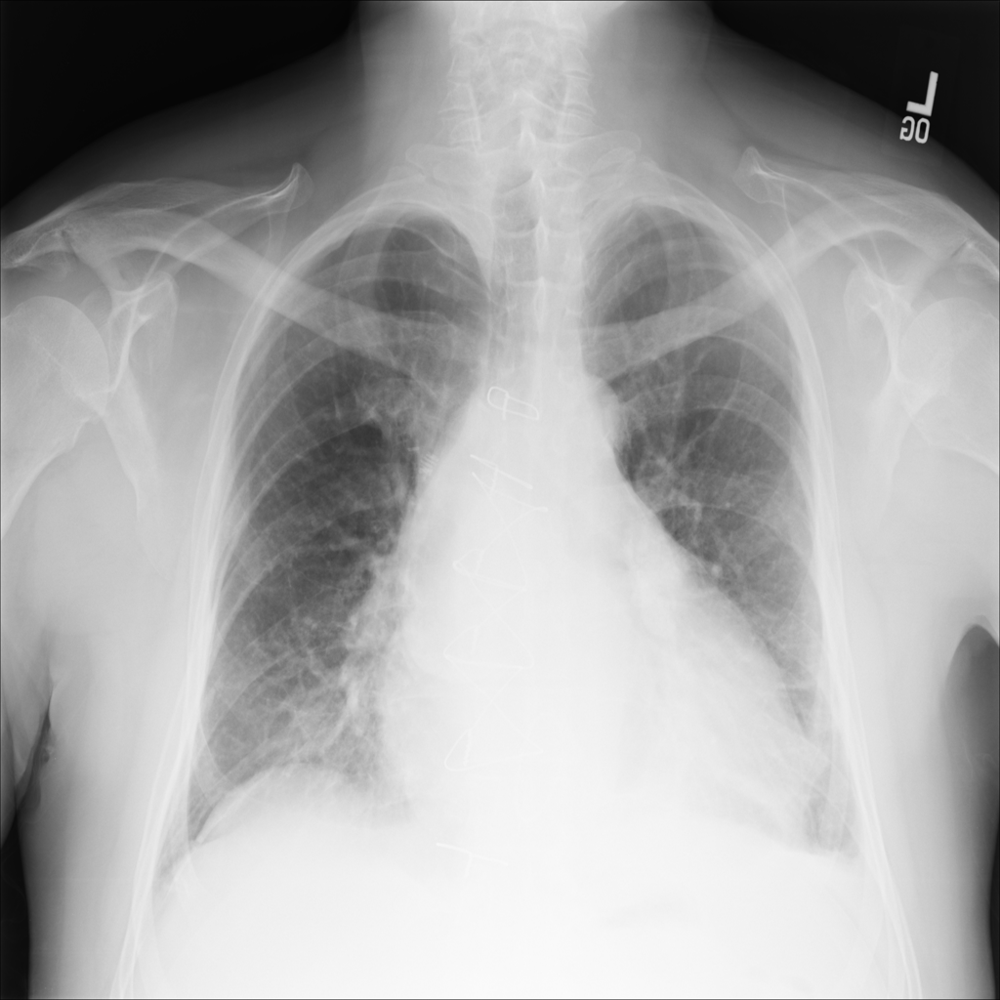

In [ ]:
path_image = xray_data['full_path'][2]
image = Image.open(path_image).convert('RGB')
image

In [ ]:
new_xray_label_emb["image"] = new_xray_label_emb["full_path"].apply(get_image)

#new_xray_file = '/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC'
#xray_data.to_csv(new_csv_file, index=False)

/tmp/ipykernel_3058302/1122879055.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_xray_label_emb["image"] = new_xray_label_emb["full_path"].apply(get_image)


In [ ]:
new_xray_label_emb.head()

,Image Index,Finding Labels,full_path,label_embeddings,image
0,00000001_000.png,Cardiomegaly,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.22390696, -0.17059186, -0.0649514, -0.270...",<PIL.Image.Image image mode=RGB size=1024x1024...
1,00000001_001.png,Cardiomegaly|Emphysema,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.17010668, 0.06432268, -0.06545948, -0.295...",<PIL.Image.Image image mode=RGB size=1024x1024...
2,00000001_002.png,Cardiomegaly|Effusion,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.2378569, -0.20667714, 0.035372637, -0.337...",<PIL.Image.Image image mode=RGB size=1024x1024...
3,00000002_000.png,No Finding,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.007388979, -0.2759555, -0.25132877, 0.221...",<PIL.Image.Image image mode=RGB size=1024x1024...
4,00000003_000.png,Hernia,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.049259044, 0.25239575, -0.33396068, 0.474...",<PIL.Image.Image image mode=RGB size=1024x1024...


In [ ]:
#new_xray_label_emb['image'][90]

In [ ]:
def get_single_image_embedding(image):
	inputs= processor(
		text = None,
		images = image,
		return_tensors="pt"
		)["pixel_values"].to(device)

	embedding = model.get_image_features(inputs)

	embedding_as_np = embedding.cpu().detach().numpy()
	return embedding_as_np



In [ ]:
type(get_single_image_embedding(image))

numpy.ndarray

In [ ]:
#Get all image embeddings

def get_all_images_embedding(df, img_column):
	df["img_embeddings"] = df[str(img_column)].apply(get_single_image_embedding)
	return df

xray_data_img_embedding = get_all_images_embedding(new_xray_label_emb, "image")


#save the new file
new_csv_file = '/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/xray_text_image_emb.csv'
xray_data_img_embedding.to_csv(new_csv_file, index=False)

/tmp/ipykernel_3058302/2464067659.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["img_embeddings"] = df[str(img_column)].apply(get_single_image_embedding)


In [ ]:


xray_data_img_embedding.head()

,Image Index,Finding Labels,full_path,label_embeddings,image,img_embeddings
0,00000001_000.png,Cardiomegaly,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.22390696, -0.17059186, -0.0649514, -0.270...",<PIL.Image.Image image mode=RGB size=1024x1024...,"[[0.1883486, -0.029017672, -0.31861869, 0.1295..."
1,00000001_001.png,Cardiomegaly|Emphysema,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.17010668, 0.06432268, -0.06545948, -0.295...",<PIL.Image.Image image mode=RGB size=1024x1024...,"[[0.2259319, -0.021755982, -0.32197025, -0.017..."
2,00000001_002.png,Cardiomegaly|Effusion,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.2378569, -0.20667714, 0.035372637, -0.337...",<PIL.Image.Image image mode=RGB size=1024x1024...,"[[0.16466753, -0.05052761, -0.2629437, 0.15458..."
3,00000002_000.png,No Finding,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.007388979, -0.2759555, -0.25132877, 0.221...",<PIL.Image.Image image mode=RGB size=1024x1024...,"[[0.15383741, -0.10204157, -0.28265917, 0.2520..."
4,00000003_000.png,Hernia,/graphics/scratch2/students/mpindabe/Datasets/...,"[[-0.049259044, 0.25239575, -0.33396068, 0.474...",<PIL.Image.Image image mode=RGB size=1024x1024...,"[[0.16815287, -0.23628268, -0.30210584, 0.1098..."


In [ ]:
def Get_concept_embeddings(concepts_dict):
    concept_embeddings = {}
    for label_name, concepts in concepts_dict.items():
        label_embeddings = []
        for concept in concepts:
          concept_embedding = get_single_text_embedding(concept)
          label_embeddings.append(concept_embedding )

        concept_embeddings[label_name] = label_embeddings

    return concept_embeddings

In [ ]:
All_concept_embeddings = Get_concept_embeddings(prompt_concepts)

In [ ]:
All_concept_embeddings.values()

dict_values([[array([[-6.97354078e-02,  2.11726353e-01, -1.86534673e-01,
         3.48286390e-01, -3.95490676e-01,  1.91673264e-01,
         1.42893106e-01, -6.94703937e-01,  3.86390835e-01,
         2.05334827e-01,  5.10768950e-01, -5.37297428e-01,
        -5.91744259e-02, -1.20254509e-01, -8.58024508e-02,
         1.57092407e-01, -1.25596210e-01,  2.02527314e-01,
        -1.56533308e-02,  3.86476934e-01, -2.18812764e-01,
        -9.34275985e-03,  1.25545844e-01,  8.46319273e-02,
        -3.67358208e-01,  2.20204860e-01, -5.81705928e-01,
         1.80164322e-01,  8.87162313e-02, -1.56654894e-01,
        -6.90027699e-02,  4.49136794e-01, -1.46452338e-01,
         1.52988106e-01, -2.12639630e-01, -1.59930229e-01,
         9.88457799e-02, -5.09038270e-01,  5.23934178e-02,
        -3.17397475e-01,  1.33468747e-01,  3.73908490e-01,
         1.12551779e-01,  1.01381764e-01,  1.03305511e-01,
         1.67729273e-01,  2.30773240e-02,  1.24800354e-01,
        -7.54397959e-02, -1.31417572e-01, 

In [ ]:
#check the shape of each concept embedding
for label_name, concepts_embeddings in All_concept_embeddings.items():
    print(f"Label: {label_name}")

    for i, concept in enumerate(concepts_embeddings):
        print(f"concept {i+1} shape: {concept.shape}")

Label: Atelectasis
concept 1 shape: (1, 512)
concept 2 shape: (1, 512)
concept 3 shape: (1, 512)
concept 4 shape: (1, 512)
concept 5 shape: (1, 512)
concept 6 shape: (1, 512)
concept 7 shape: (1, 512)
concept 8 shape: (1, 512)
concept 9 shape: (1, 512)
concept 10 shape: (1, 512)
concept 11 shape: (1, 512)
concept 12 shape: (1, 512)
concept 13 shape: (1, 512)
concept 14 shape: (1, 512)
concept 15 shape: (1, 512)
concept 16 shape: (1, 512)
concept 17 shape: (1, 512)
concept 18 shape: (1, 512)
concept 19 shape: (1, 512)
concept 20 shape: (1, 512)
concept 21 shape: (1, 512)
concept 22 shape: (1, 512)
concept 23 shape: (1, 512)
concept 24 shape: (1, 512)
concept 25 shape: (1, 512)
Label: Cardiomegaly
concept 1 shape: (1, 512)
concept 2 shape: (1, 512)
concept 3 shape: (1, 512)
concept 4 shape: (1, 512)
concept 5 shape: (1, 512)
concept 6 shape: (1, 512)
concept 7 shape: (1, 512)
concept 8 shape: (1, 512)
concept 9 shape: (1, 512)
concept 10 shape: (1, 512)
concept 11 shape: (1, 512)
concept

In [ ]:
xray_data_img_embedding.iloc[0]['img_embeddings']

array([[ 1.88348606e-01, -2.90176719e-02, -3.18618685e-01,
         1.29595786e-01, -6.83517158e-02,  2.07110047e-01,
         4.49989498e-01,  1.59205243e-01,  6.99243426e-01,
        -2.58633763e-01,  7.06738472e-01, -3.49417657e-01,
         5.30320823e-01,  1.68878466e-01,  3.27775508e-01,
        -4.59010959e-01,  6.91227913e-01, -1.47655249e-01,
         3.43386680e-02, -1.76697392e-02, -5.02967954e-01,
         1.54628530e-01,  5.44753134e-01,  2.40948856e-01,
        -2.96941638e-01, -2.86983997e-01, -1.35889649e-01,
         1.45161510e-01, -1.96292907e-01,  9.04920548e-02,
        -4.27057236e-01,  4.98827279e-01,  1.28571197e-01,
         3.23827527e-02, -8.10433179e-02, -2.84865588e-01,
         2.29528502e-01, -4.80807334e-01, -4.35419500e-01,
        -1.29517615e-02, -5.13732135e-01, -2.05505967e-01,
        -8.13702345e-02, -5.73167622e-01,  5.05542636e-01,
        -7.31529117e-01, -6.44980550e-01,  3.88466030e-01,
         3.52215767e-03, -5.79880178e-01,  3.61056030e-0

### 3. Simularity between image_embedding and concepts embeddings

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

def Compute_similarity_scores(image_embeddings, concept_embeddings):
    similarity_scores = {}

    # Iterate over each image embedding
    for image_id, image_embedding in enumerate(image_embeddings):
        # Compute cosine similarity between image embedding and each concept embedding
        similarity_scores[image_id] = {}
        for class_name, embeddings in concept_embeddings.items():
            similarity_scores[image_id][class_name] = []
            for embedding in embeddings:
                similarity_score = cosine_similarity(image_embedding.reshape(1, -1), embedding)
                similarity_scores[image_id][class_name].append(similarity_score)
    return similarity_scores

In [ ]:
similarity_scores = Compute_similarity_scores(xray_data_img_embedding['img_embeddings'], All_concept_embeddings)

In [ ]:
similarity_scores

{0: {'Atelectasis': [array([[0.3264646]], dtype=float32),
   array([[0.2968562]], dtype=float32),
   array([[0.32717907]], dtype=float32),
   array([[0.3048008]], dtype=float32),
   array([[0.28253013]], dtype=float32),
   array([[0.2998299]], dtype=float32),
   array([[0.31271452]], dtype=float32),
   array([[0.283079]], dtype=float32),
   array([[0.29404533]], dtype=float32),
   array([[0.32364035]], dtype=float32),
   array([[0.30316275]], dtype=float32),
   array([[0.21824944]], dtype=float32),
   array([[0.18712799]], dtype=float32),
   array([[0.291187]], dtype=float32),
   array([[0.20731972]], dtype=float32),
   array([[0.20579955]], dtype=float32),
   array([[0.21490873]], dtype=float32),
   array([[0.2977544]], dtype=float32),
   array([[0.26786298]], dtype=float32),
   array([[0.19505528]], dtype=float32),
   array([[0.30197442]], dtype=float32),
   array([[0.22928128]], dtype=float32),
   array([[0.2569684]], dtype=float32),
   array([[0.23127806]], dtype=float32),
   array

In [ ]:
#for image_index, scores in similarity_scores.items():
 #   print("Image Index:", image_index)
 #   for class_name, class_scores in scores.items():

   #     list_score = []
   #     for i, score in enumerate(class_scores):
    #3        list_score.append(score[0][0])
    #        #print("Score", i+1, ":", score[0])
     #   print("Concept_Scores", i+1, ":",(list_score))

In [ ]:
#check the number of concept for each label
for idx, concepts in similarity_scores.items():
  vector_map= []
  print(f"imag: {idx}")
  for label, score in concepts.items():
    for i, sc in enumerate(score):
      vector_map.append(sc[0][0])

  print("score_concepts ", ((vector_map)))

imag: 0
score_concepts  [0.3264646, 0.2968562, 0.32717907, 0.3048008, 0.28253013, 0.2998299, 0.31271452, 0.283079, 0.29404533, 0.32364035, 0.30316275, 0.21824944, 0.18712799, 0.291187, 0.20731972, 0.20579955, 0.21490873, 0.2977544, 0.26786298, 0.19505528, 0.30197442, 0.22928128, 0.2569684, 0.23127806, 0.21142766, 0.23631908, 0.2800995, 0.26627597, 0.28222027, 0.22770844, 0.26278153, 0.30907774, 0.29677787, 0.2844542, 0.26982206, 0.26555857, 0.3105071, 0.25757146, 0.2946178, 0.22770844, 0.27655572, 0.23227258, 0.2181557, 0.1877794, 0.31348017, 0.2652121, 0.22928128, 0.21840128, 0.20403127, 0.2104254, 0.2618032, 0.24916673, 0.20452891, 0.2973171, 0.26077288, 0.28150487, 0.2181557, 0.18918051, 0.30809808, 0.27463853, 0.3120916, 0.28511465, 0.23570038, 0.24823697, 0.2633845, 0.20422885, 0.29924834, 0.21841213, 0.21517414, 0.3081072, 0.2947652, 0.27434832, 0.20983087, 0.21043517, 0.26627597, 0.24943988, 0.31166235, 0.22475576, 0.22497821, 0.291187, 0.22669312, 0.29693794, 0.31370527, 0.3023

In [ ]:
matrix = np.zeros((len(similarity_scores), 249))

for idx, concepts in similarity_scores.items():
    row = []
    for label, score in concepts.items():
        for i, sc in enumerate(score):
            row.append(sc[0][0])
    matrix[idx] = row

print(matrix)

[[0.32646459 0.29685619 0.32717907 ... 0.30692488 0.32132146 0.31279814]
 [0.32568175 0.30055141 0.33062133 ... 0.3087877  0.32693657 0.31829578]
 [0.33495784 0.29546353 0.33118105 ... 0.30021954 0.32548118 0.31382677]
 ...
 [0.32789266 0.29671073 0.32978421 ... 0.3118864  0.32168958 0.30965891]
 [0.32016963 0.2967371  0.32526487 ... 0.31245559 0.32955891 0.31446692]
 [0.32092196 0.30845621 0.32350361 ... 0.3144381  0.32825744 0.31690723]]


In [ ]:
matrix.shape

(300, 249)

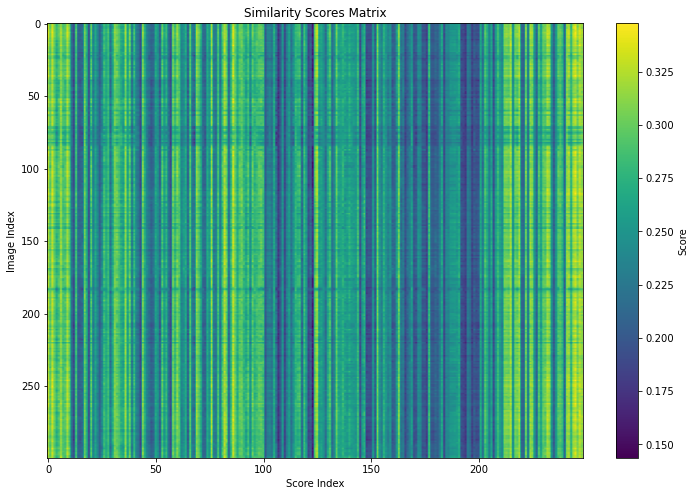

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
plt.imshow(matrix, cmap='viridis', aspect='auto')
plt.colorbar(label='Score')
plt.xlabel('Score Index')
plt.ylabel('Image Index')
plt.title('Similarity Scores Matrix')
plt.show()

In [ ]:
#check the shape of each concept embedding
for img_id, scores in similarity_scores.items():
    list_score = []
    print(f"image: {img_id}")
    # Print the length of each concepts
    for i, score in scores.items():
        list_score.append(score)
        print(f"concept {i+1} len: {list_score}")

image: 0


TypeError: can only concatenate str (not "int") to str

In [ ]:
for idx, concepts in similarity_scores.items():
  class_embeddings = []
  print(f"imag: {idx}")
  for label, score in concepts.items():
    for i, sc in enumerate(score):
      class_embeddings.append(score)

  print("score_concepts ", ((class_embeddings)))

In [ ]:
top_k = 10
for img_id, similarity_score in similarity_scores.items():
    score_list = []
    #print(f"imag: {idx}")
    for label, scores in similarity_score.items():
        for i, score in enumerate(scores):
            print(f"Top {top_k} concepts related to image {img_id}:")

            # Sort the scores in descending order and get the top_k scores
            top_scores = sorted(score, reverse=True)[:top_k]


            print(f"Concept {i+1}: Similarity Score = {top_scores}")

            print("\n")


Top 10 concepts related to image 0:
Concept 1: Similarity Score = [array([0.3264646], dtype=float32)]


Top 10 concepts related to image 0:
Concept 2: Similarity Score = [array([0.2968562], dtype=float32)]


Top 10 concepts related to image 0:
Concept 3: Similarity Score = [array([0.32717907], dtype=float32)]


Top 10 concepts related to image 0:
Concept 4: Similarity Score = [array([0.3048008], dtype=float32)]


Top 10 concepts related to image 0:
Concept 5: Similarity Score = [array([0.28253013], dtype=float32)]


Top 10 concepts related to image 0:
Concept 6: Similarity Score = [array([0.2998299], dtype=float32)]


Top 10 concepts related to image 0:
Concept 7: Similarity Score = [array([0.31271452], dtype=float32)]


Top 10 concepts related to image 0:
Concept 8: Similarity Score = [array([0.283079], dtype=float32)]


Top 10 concepts related to image 0:
Concept 9: Similarity Score = [array([0.29404533], dtype=float32)]


Top 10 concepts related to image 0:
Concept 10: Similarity Sc

In [ ]:
def plot_similarity_map(similarity_scores):
    for image_id, class_scores in similarity_scores.items():
        plt.figure(figsize=(10, 6))
        plt.title(f"Similarity Map for Image {image_id}")
        for class_name, scores in class_scores.items():
            scores = np.array(scores).flatten()
            plt.plot(scores, label=class_name)
        plt.xlabel("Concept")
        plt.ylabel("Similarity Score")
        #plt.xticks(ticks=range(len(scores)), labels=[concept for concept in class_scores.keys()], rotation=45)
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

In [ ]:
def similarity(image_encoders, concept_encoders):
    # Normalize the encoders
    image_encoders = torch.nn.functional.normalize(image_encoders, dim=-1)
    concept_encoders = torch.nn.functional.normalize(concept_encoders, dim=-1)

    # Compute the cosine similarity between each image encoder and concept encoder
    similarities = torch.matmul(image_encoders, concept_encoders.T)

    return similarities